# A Crash Course in the Compton Data Space (CDS)

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider, Button
import pandas as pd
import plotly.graph_objects as go
import dash
from dash import html
from dash import dcc

from points import points
from calculate_phi import calculate_phi

### Check notebook formatting if you'd like

In [2]:
#!nbqa flake8 cds-vis.ipynb

## What is the CDS?

The Compton Data Space (CDS; [Schönfelder et al. 1993](https://ui.adsabs.harvard.edu/abs/1993ApJS...86..657S/abstract); [Zoglauer et al. 2021](https://ui.adsabs.harvard.edu/abs/2021arXiv210213158Z/abstract)) is a data space developed specifically for Compton telescopes which parameterizes photon interactions by their scattering angles. The CDS was first conceptualized by the COMPTEL collaboration as the "COMPTEL Data Space" and is more broadly used today in several Compton telescope experiments as the "Compton Data Space." 

Please refer to the above linked papers for detailed descriptions of COMPTEL, a "classic" Compton telescope, and the general operating principle of Compton telescopes, including more modern "compact" Compton telescopes. [Zoglauer 2005](https://mediatum.ub.tum.de/node?id=603105) is an additional resource with extensive explanations of the constituent measurement process and event reconstruction techniques.

The CDS is spanned by three parameters which specify the observed Compton scattering process as well as the measured changed state of the incident $\gamma$-ray: the Compton scattering angle ($\phi \in [0^{\circ}, 180^{\circ}]$) describes the former and the latter is given by the polar ($\psi \in [0^{\circ}, 180^{\circ}]$) and azimuthal ($\chi \in [-180^{\circ}, 180^{\circ}]$) directions of the scattered $\gamma$-ray in Galactic coordinates. These three parameters describe the arrival direction of the $\gamma$-ray. 

Each incident photon is uniquely defined by these three parameters in the CDS. In contrast to the degenerate image space of Compton telescopes with overlapping circles projected on the sky, the CDS is a well-defined and powerful space for disciminatory analyses which do not require imaging. Imaging techniques will be discussed later in this document.

### How can we visualize the CDS?

The below figure from [Zoglauer et al. 2021](https://ui.adsabs.harvard.edu/abs/2021arXiv210213158Z/abstract) illusrates the connection between the Compton scattering process and the CDS.

In the left figure, the origin, i.e. true (point) source location, of an incident $\gamma$-ray is given by ($\psi_0, \xi_0$). The $\gamma$-ray undergoes a Compton interaction with the detector material (red point) and subsequently moves in a different direction. The path of the scattered $\gamma$-ray is defined by the coordinates of its final interaction in the 2-D plane spanned by Galactic longitude $\psi$ and Galactic latitude $\xi$. Note that the photons are originally measured in terms of the instrument's local detector coordinate system. The conversion between detector coordinates and the Galactic coordinates referred to in this discussion is explained in [Sleator 2019](https://www.proquest.com/openview/04a692b85b615efbdfc3bca56057d674/1?pq-origsite=gscholar&cbl=51922&diss=y&casa_token=v0kMBMkXsRsAAAAA:q4GU3pWPY7Q1upR9VHobwiMnEky9JL4-uGy2Pn3CAod8xfRPSETJwYOnoIDeN4Aad_GtjbQd0H_D).

The right figure illustrates what is frequently referred to as the "Compton cone." Photons detected from the point source origin located at ($\psi_0, \xi_0$) populate the surface of a hollow 3-D cone in the CDS. The opening angle of the Compton cone is 90$^{\circ}$.

Say that the photon scatters at Compton scatter angle $\phi = \phi_{\text{scatt}}$. As $\phi_{\text{scatt}}$ increases, the photon deviates further from its original path and lands at any ($\psi, \xi$) on the circle which traces the surface of the cone bisected by the 2-D plane ($\phi = \phi_{\text{scatt}}, \psi, \chi$). These are the "circles on the sky" often mentioned in explanations of Compton event reconstruction. A photon with $\phi_{\text{scatt}} = 0^{\circ}$ does not deviate from its original path and is therefore found in the CDS precisely at its origin ($\psi_0, \xi_0$), the apex of the cone.  

It is important to note that this is a simplified explanation of the scattering process and as such, the CDS is a simplified data space. The CDS does not encode the redundant kinematic and geometric information gleaned from real events which Compton scatter multiple times throughout the instrument. This information is key to Compton event reconstruction, e.g. Compton Kinematic Discrimination ([Boggs and Jean 2000](https://aas.aanda.org/articles/aas/ps/2000/14/h2143.ps.gz)). Furthermore, the Compton cone in the below figure is not uniformly populated, i.e. certain scatter angles are more probable than others given interaction probabilities governed by the Klein-Nishina equation. For example, the Klein-Nishina equation is dependent on the energy and polarization of the incident photon. The geometry of the detector itself also influences the probability of observing certain scatter angles. Comparing COMPTEL's "classic" Compton telescope design to the "compact" Compton telescope design of [COSI](https://cosi.ssl.berkeley.edu/) ([Tomsick et al. 2021](https://ui.adsabs.harvard.edu/abs/2019AAS...23313605T/abstract)) makes this point clear: COMPTEL was comprised of a scattering and absorbing plane placed > 2 meters apart ([Schönfelder et al. 1993](https://scholars.unh.edu/ssc/221/)). Photons scattered at large Compton scatter angles would not hit the absorbing plane and escape detection. COSI's compact stack of detectors can detect photons scattered at much broader range of scatter angles.

![title](zoglauer_arxiv2102.13158_fig3.png)

### Interact with the CDS with ```matplotlib```

Use the ```matplotlib``` sliders to define the post-Compton scatter interaction location in terms of Galactic longitude and latitude ($\psi, \xi$). The Compton scatter angle $\phi$ which induced the scattered photon trajectory is calculated and displayed near the vertex of the interaction and in the figure of the Compton cone to the right.

Click and drag the frames to pan, zoom, and explore the CDS. 

For enhanced performance later in the notebook, click the power button in the top right corner of the figure to disable interactivity once you're done exploring.

### Use pytest to check the calculate_phi function, which the notebook relies on

In [3]:
!pytest test.py

============================= test session starts ==============================
platform darwin -- Python 3.9.10, pytest-6.2.5, py-1.11.0, pluggy-1.0.0
rootdir: /Volumes/JB/COSI/cds-visualization
plugins: anyio-3.5.0, dash-2.3.1, nbmake-0.5
collected 3 items                                                              

test.py ...                                                              [100%]

============================== 3 passed in 1.03s ===============================


<IPython.core.display.Javascript object>


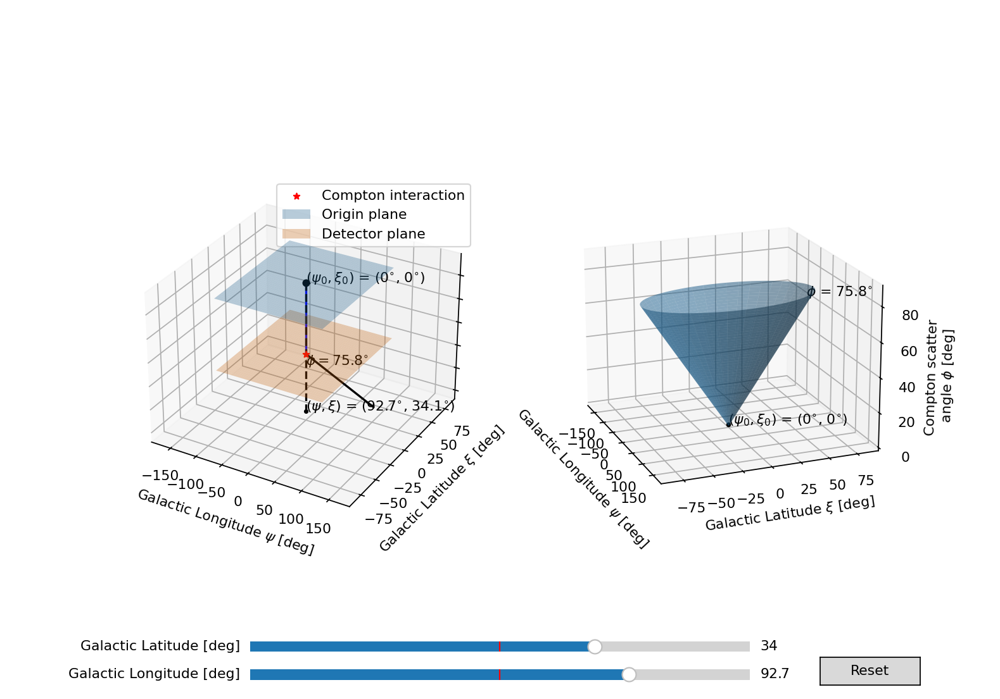

In [4]:
# Launch interactive matplotlib functionality
%matplotlib notebook

# Create figure with two 3D subplots
fig = plt.figure(figsize=(10,7))

ax = fig.add_subplot(1, 2, 1, projection='3d')
ax2 = fig.add_subplot(1, 2, 2, projection='3d')


# Set axes
ax.set_xlim(-180, 180)
ax.set_ylim(-90, 90)
ax.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
ax.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
ax.zaxis.set_ticklabels([])

ax2.set_xlim(-180, 180)
ax2.set_ylim(-90, 90)
ax2.set_zlim(0, 90)
ax2.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
ax2.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
ax2.set_zlabel('Compton scatter' + '\n' + r' angle $\phi$ [deg]')


# Initially displayed longitude and latitude
init_lon = 0
init_lat = 0

# Get coordinates of origin, Compton scatter, and post-scatter
#  interactions from initial longitude and latitude
x, y, z = points(lon=init_lon, lat=init_lat)

# Plot the above three points
ax.scatter(x[0], y[0], z[0], c='k')
ax.scatter(x[1], y[1], z[1], c='r',marker='*',label='Compton interaction')
ax.scatter(x[2], y[2], z[2], c='k', marker='.')

ax2.scatter(0, 0, 0, c='k', s=6)

# Annotate origin point
origin_annot = ax.text(x[0], y[0], z[0],
                          r'($\psi_0, \xi_0$) = ({}'.format(x[0]) + 
                          r'$^{\circ}$' + ', {}'.format(y[0]) + r'$^{\circ}$)')

origin_annot_2 = ax2.text(0, 0, 0,
                          r'($\psi_0, \xi_0$) = ({}'.format(0) + 
                          r'$^{\circ}$' + ', {}'.format(0) + r'$^{\circ}$)')

# Plot a line through all three points
line0 = ax.plot(x[:2], y[:2], z[:2],"b")
line, = ax.plot(x[1:], y[1:], z[1:], 'k')

# Plot a vertical dashed line along phi = 0
ax.plot([x[0], x[1]], [y[0], y[1]], [z[0], z[2]], 'k--')

# Calculate and annotate phi, given x and y 
phi = calculate_phi(init_lon, init_lat)
phi_annot = ax.text(0, 0, 20, r'$\phi = $' + str(round(phi,1)) + r'$^{\circ}$')

# Annotate x, y
xy_annot = ax.text(x[-1], y[-1], z[-1], r'($\psi, \xi$) = ({}'.format(round(x[-1], 1)) + 
                      r'$^{\circ}$' + ', {}'.format(round(y[-1], 1)) + r'$^{\circ}$)')

# Plot origin plane
xx0, yy0 = np.meshgrid(range(-100,100), range(-60,60))
zz0 = np.full_like(xx0, z[0])
surf0 = ax.plot_surface(xx0, yy0, zz0, alpha=0.3, label="Origin plane")
surf0._edgecolors2d = surf0._edgecolor3d
surf0._facecolors2d = surf0._facecolor3d

# Plot detector plane
xx, yy = np.meshgrid(range(-100,100), range(-60,60))
zz = np.full_like(xx, z[1])
surf = ax.plot_surface(xx, yy, zz, alpha=0.3, label="Detector plane")
surf._edgecolors2d = surf._edgecolor3d
surf._facecolors2d = surf._facecolor3d


##########


# Create longitude and latitude sliders for post-scatter interaction
axlon = plt.axes([0.25, 0.02, 0.5, 0.03])
lon_slider = Slider(ax=axlon, label='Galactic Longitude [deg]', valmin=-180, valmax=180, valinit=init_lon)

axlat = plt.axes([0.25, 0.06, 0.5, 0.03])
lat_slider = Slider(ax=axlat, label='Galactic Latitude [deg]', valmin=-90, valmax=90, valinit=init_lat)


# Update the longitude and latitude values
def update(val):
    """
    Update the post-scatter interaction location in the left subplot 
    with the values indicated in the matplotlib sliders.
    
    Calculate the Compton scatter angle phi corresponding to this
    final location and update the Compton cone in the right subplot. 
    
    Update all corresponding annotations.
    """
    # Clear the right subplot to remove cone from previous
    #  slider settings
    ax2.clear()
    
    # Left subplot: Find new x, y, z given slider values
    x, y, z = points(lon_slider.val, lat_slider.val)
    line.set_data_3d(x[1:], y[1:], z[1:])
    
    # Left subplot: Annotate this new post-scatter location
    xy_annot.set_text(r'($\psi, \xi$) = ({}'.format(round(x[-1], 1)) + 
                      r'$^{\circ}$' + ', {}'.format(round(y[-1], 1)) + r'$^{\circ}$)')
    
    # Left subplot: Update and annotate phi
    new_phi = round(calculate_phi(lon_slider.val, lat_slider.val), 1)
    phi_annot.set_text(r'$\phi = $' + str(new_phi) + r'$^{\circ}$')
    
    # Right subplot: Plot cone corresponding to new phi 
    height = new_phi
    radius = height*np.tan(np.pi/4.)

    # Right subplot: Set up a polar grid in radians
    theta = np.linspace(0, 2*np.pi, 90)
    r = np.linspace(0, radius, 50)
    th, rad = np.meshgrid(theta, r)

    # Right subplot: Calculate X, Y, Z (cone surface)
    X = rad*np.cos(th) 
    Y = rad*np.sin(th) 
    Z = np.sqrt(X**2 + Y**2) - 1

    # Right subplot: Set axes
    ax2.set_xlim(-180, 180)
    ax2.set_ylim(-90, 90)
    ax2.set_zlim(0, 90)
    ax2.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
    ax2.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
    ax2.set_zlabel('Compton scatter' + '\n' + r' angle $\phi$ [deg]')

    # Right subplot: Plot and annotate the origin point
    ax2.scatter(x[0], y[0], 0, c='k', s=6)
    origin_annot_2 = ax2.text(x[0], y[0], 0,
                              r'($\psi_0, \xi_0$) = ({}'.format(x[0]) + 
                              r'$^{\circ}$' + ', {}'.format(y[0]) + r'$^{\circ}$)')
    
    # Right subplot: Annotate phi
    phi_annot_2 = ax2.text(0.75*radius, 0.75*radius, new_phi, 
                           r'$\phi$ = {}'.format(new_phi) + r'$^{\circ}$')
    
    # Right subplot: Plot the cone
    ax2.plot_surface(X, Y, Z, alpha = 0.5)

    
    # Draw canvas
    fig.canvas.draw() 
    fig.canvas.flush_events()

lon_slider.on_changed(update)
lat_slider.on_changed(update)


###########


# Create a reset button to reset lon and lat to initial values
resetax = plt.axes([0.82, 0.02, 0.1, 0.04])
button = Button(resetax, 'Reset', hovercolor='0.975')


def reset(event):
    """
    Create a reset button to reset lon and lat sliders
    to their shared initial value of 0 degrees.
    """
    lon_slider.reset()
    lat_slider.reset()
    
button.on_clicked(reset)


ax.legend();


### Interact with the CDS with ```plotly```

Instead of specifying the Galactic longitude and latitude ($\psi, \xi$) of the post-scatter location, use the slider bar to choose a Compton scatter angle $\phi$. The possible ($\psi, \xi$) coordinates which correspond to that $\phi$ appear as a circle in the $\psi-\xi$ plane. 

Like ```matplotlib```, you can pan, zoom, etc. With ```dash```, the figure can be exported to HTML and opened in any web browser.

If you open the plot in a new browser tab by clicking on the link following "Dash is running on...", interrupt the Jupyter notebook kernel when you're done to close the connection.

Note: this is toy model of the scattering process and the CDS. It does not incorporate real scattering cross-sections, interaction probabilities, and the resulting non-uniformity in scattering angle probabilities (see above discussion). It is simplified method of viewing the CDS. 

In [5]:
# Make a dataframe with phi values and possible lon/lat values
inc = 1
lons = np.arange(-180, 180 + inc, inc)
lats = np.arange(-90, 90 + inc, inc)

d = {}

for lon in lons:
    for lat in lats:
        phi = round(calculate_phi(lon, lat), 1)
                
        if phi not in d:
            d[phi] = [[lon], [lat]]
                      
        else:
            d[phi][0].append(lon)
            d[phi][1].append(lat)

In [6]:
df = pd.DataFrame.from_dict(d, orient='index', columns=['lon', 'lat'])
df.index.name = 'phi'
df.head()

,lon,lat
phi,,
82.9,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-90, -89, -88, -87, -86, 86, 87, 88, 89, 90, ..."
82.8,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-85, -84, -83, -82, -81, -80, -79, 79, 80, 81..."
82.7,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-78, -77, -76, -75, -74, -73, -72, 72, 73, 74..."
82.6,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-71, -70, -69, -68, -67, -66, -65, 65, 66, 67..."
82.5,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-64, -63, -62, -61, -60, -59, -58, -57, 57, 5..."


In [7]:
import io
from base64 import b64encode
buffer = io.StringIO()

# Set initial scatter locations
x = [0, 0, 0] 
y = [0, 0, 0] 
z = [55, 25, 0]

# Define the origin point
init_point = go.Scatter3d(
                x = [x[0]], 
                y = [y[0]], 
                z = [z[0]],
                mode = 'markers',
                marker = dict(
                    size = 4,
                    color = 'black',
                    opacity = 0.8
                ),
                visible = True,
                name = 'Origin'
            )


# Define the Compton interaction
scatter_point = go.Scatter3d(
                x = [x[1]], 
                y = [y[1]], 
                z = [z[1]],
                mode = 'markers',
                marker = dict(
                    size = 4,
                    color = 'red',
                    opacity = 0.8
                ),
                visible = True,
                name = 'Compton interaction'
            )


# Define a line to show the inital path
init_path = go.Scatter3d(
                x = x[:2], 
                y = y[:2], 
                z = z[:2],
                mode = 'lines',
                line_color = 'black',
                opacity = 0.8,
                showlegend=False,
                visible = True
            )


# Define the origin plane by its four corners
origin_plane = {'type': 'mesh3d',
               'x': [-90, -90, 90, 90],
               'y': [-180, 180, -180, 180],
               'z': [z[0], z[0], z[0], z[0]],
               'color': 'blue',
               'opacity': 0.3,
               'visible': True,
               'name': 'Origin plane'}


# Define the detector plane by its four corners
detector_plane = {'type': 'mesh3d',
                   'x': [-90, -90, 90, 90],
                   'y': [-180, 180, -180, 180],
                   'z': [z[1], z[1], z[1], z[1]],
                   'color': 'orange',
                   'opacity': 0.3,
                   'visible': True,
                   'name': 'Detector plane'}


# Add scatter path and final interaction point
#  as a function of phi
traces = []
phis = df.index[::-1]

paths = []

for step in phis: 
#    phi = step
#     lon = df.loc[df.index == phi, 'lon'].tolist()[0]
#     lat = df.loc[df.index == phi, 'lat'].tolist()[0]
    
    # Query the database with DataFrame.query, just to try something
    #  different than the usual above syntax
    lon = df.query(f"phi == {step}")[['lon']]['lon'].tolist()[0]
    lat = df.query(f"phi == {step}")[['lat']]['lat'].tolist()[0]
    
    phi = step
    
    x_test = [x[1]] + lon  
    y_test = [y[1]] + lat
    z_test = [z[1]] + [0]*len(lat)
     
    # Plot points to show possible scatter locations
    trace = go.Scatter3d(
                x = lon, 
                y = lat, 
                z = [0]*len(lat),
                mode = 'markers',
                marker = dict(
                    size = 3,
                    color = 'green',
                    opacity = 0.8
                ),
                text = [f'$\phi$ = {phi}' + r'$^{\circ}$'],
                textposition = 'bottom right',
                visible = False,
                name = 'Possible post-scatter locations'
            )
            
    traces.append(trace)
    
    # Plot line to show one corresponding scatter path
    scatt_path = go.Scatter3d(
                    x = [x[1], lon[0]], 
                    y = [y[1], lat[0]], 
                    z = [z[1], 0],
                    mode = 'lines',
                    line_color = 'green',
                    opacity = 0.8,
                    visible = False,
                    name = 'Possible scatter path'
                )
    
    paths.append(scatt_path)

# Make the initial scatter visible  
traces[0]['visible'] = True
paths[0]['visible'] = True

# Concatenate all the scatter points, paths, and planes
#  to pass to the figure later on
data = list(np.copy(traces)) + list(np.copy(paths))
data.extend([init_point, 
            scatter_point,
            init_path,
            origin_plane, 
            detector_plane])


# Create slider
steps = []
for i in range(len(traces)-1):
    step = dict(
        method = 'restyle',  
        args = ['visible', [False] * len(data), 
                {"title": "Compton scattering angle: " + str(phis[i]) + " deg"}],
        label = str(phis[i])
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible" (the scattered ray)
    step['args'][1][i + len(paths)] = True

    # Make the rest of the elements visible
    for j in range(len(traces) + len(paths), len(data)):
        step['args'][1][j] = True

    steps.append(step)


sliders = [dict(
    active = 0,
    currentvalue = {"prefix": "Compton scattering angle: ", "suffix": " deg"},
    pad = {"t": 5},
    steps = steps

)]


# Create the layout
layout = go.Layout(title = 'Compton scattering in the CDS', 
                    margin=go.layout.Margin(
                    l = 0,  # left margin
                    r = 0,  # right margin
                    b = 0,  # bottom margin
                    t = 50, # top margin
                    ),                  
                    sliders = sliders)

# Create the figure and give it the data from above
fig = go.Figure(data = data, 
                layout = layout)


# Update axes in the figure
fig.update_layout(scene=dict( 
                    xaxis_title='Galactic Latitude <br>' + r'$\xi$'+' [deg]',
                    xaxis = dict(
                                tickmode = 'array',
                                tickvals = [-90, -60, -30, 0, 30, 60, 90]
                                ),
    
                    yaxis_title='Galactic Longitude <br>' + r'$\psi$'+' [deg]',
                    yaxis = dict(
                                tickmode = 'array',
                                tickvals = [-180, -120, -60, 0, 60, 120, 180]
                                ),
    
                    zaxis_title='',
                    zaxis = dict(
                                tickmode = 'array',
                                tickvals = []
                                )
                     )
                 )


# Save a static jpeg. The below write_image 
#  functionality requires kaleido
fig.write_image("cds_vis.jpeg")
fig.show()


# Export as html with dash
fig.write_html(buffer)

html_bytes = buffer.getvalue().encode()
encoded = b64encode(html_bytes).decode()

app = dash.Dash()

app.layout = html.Div([
    html.H4('Simple plot export options'),
    html.P("↓↓↓ try downloading the plot as PNG ↓↓↓", style={"text-align": "right", "font-weight": "bold"}),
    dcc.Graph(id="graph", figure=fig),
    html.A(
        html.Button("Download as HTML"), 
        id="download",
        href="data:text/html;base64," + encoded,
        download="cds_vis.html"
    )
])

# use_reloader=False necessary for Jupyter notebook
app.run_server(debug=True, use_reloader=False)

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app '__main__' (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on


### A static rendering of the plotly visualization:

![static_plotly_cds](cds_vis.jpeg)

# Introduction to Compton imaging

## There are two main approaches to imaging:
1. Fitting method
2. Richardson-Lucy deconvolution

## 1. Fitting method

The instrument **response** takes our data from physical to measured units.

What *is* the response?

In a literal sense, the response encodes how the instrument responds to, or interprets and records, incident photons. It relates photon interactions, as recorded in the local detector coordinates, to the photon's origin in the sky. This is critical for imaging analyses which seek to project data recorded by the instrument in the CDS back onto the 2D sky in Galactic coordinates. Visualizing source distributions in this way can reveal the true morphologies of $\gamma$-ray emission. Of particular interest are the mysteriously strong signature of positron-electron annihilation (511 keV) near the Galactic Center and sites of stellar/explosive nucleosynthesis as traced by $^{26}$Al (1.809 MeV), $^{60}$Fe (1.173 and 1.333 MeV), $^{44}$Ti (1.157 MeV; also 68 and 78 keV in hard X-rays), and $^{56}$Co (847 keV and 1.238 MeV).

A bit of mathematical notation can help. Consider the response as a function of coordinates:

$R(Z, A; \phi, \psi, \chi)$

Z = zenith (angle in instrument coordinates)

A = azimuth (angle in instrument coordinates)

$(\phi, \psi, \chi)$ are the CDS angles. 

Note that Z and A point to a location on the sky via a unique mapping of $(Z, A) \leftrightarrow (\ell, b)$, i.e. Galactic longitude and latitude. This mapping is calculated with "Great Circles," trig functions, etc. See [this](http://www.tu-berlin.de/fileadmin/fg169/miscellaneous/Quaternions.pdf) document for an explanation of transforming spacecraft coordinates.  

When we measure, we implicitly sort photons from the sky into our data space (the CDS). We can picture this as a cube spanned by the three parameters of the CDS:

<IPython.core.display.Javascript object>


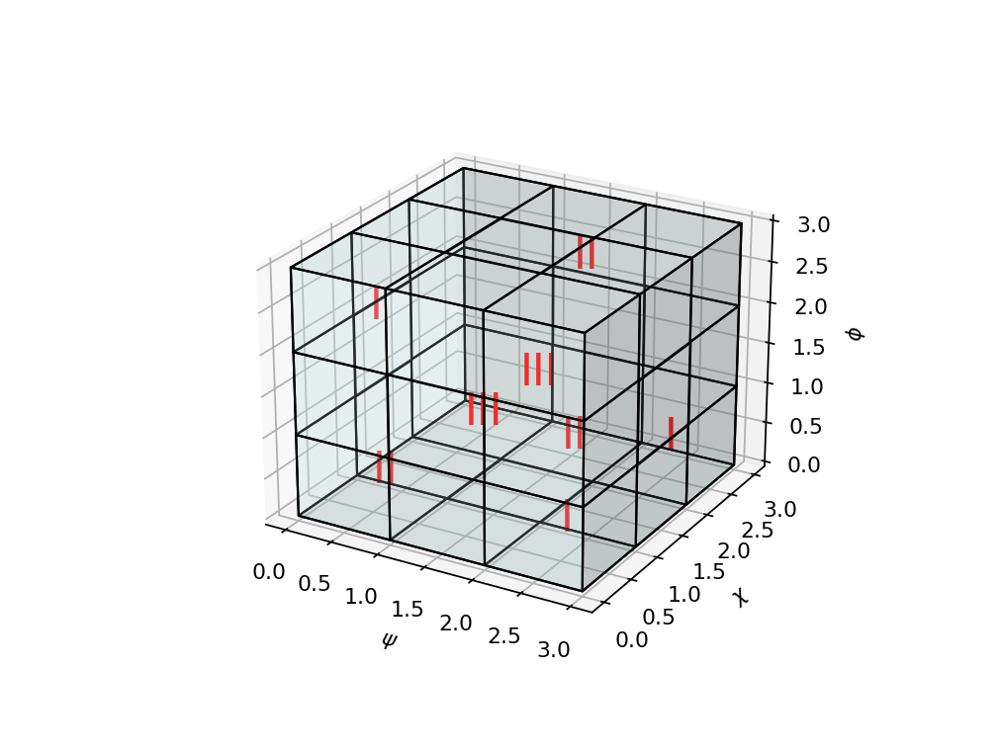

In [8]:
%matplotlib notebook

# From matplotlib docs, create a 3D voxel/volumetric plot: 
#      https://matplotlib.org/stable/gallery/mplot3d/voxels.html
# prepare some coordinates
x, y, z = np.indices((3, 3, 3))

# draw cuboids in the top left and bottom right corners, and a link between
# them
cube1 = (x < 3) & (y < 3) & (z < 3)

# combine the objects into a single boolean array
voxelarray = cube1

# set the colors of each object
colors = np.empty(voxelarray.shape, dtype=object)
colors[cube1] = 'lightcyan'

# and plot everything
ax = plt.figure().add_subplot(projection='3d')
ax.voxels(voxelarray, facecolors=colors, edgecolor='k', alpha=0.2)


# Axis labels
ax.set_xlabel(r'$\psi$')
ax.set_ylabel(r'$\chi$')
ax.set_zlabel(r'$\phi$')

# Annotations
ax.text(0.5, 0.5, 2.3, 'I', c='red', fontsize=20)
ax.text(1.5, 1.5, 1.3, 'III', c='red', fontsize=20)
ax.text(1.5, 0.5, 1.3, 'III', c='red', fontsize=20)
ax.text(2.5, 2.5, 0.3, 'I', c='red', fontsize=20)
ax.text(2.5, 0.5, 0.3, 'I', c='red', fontsize=20)
ax.text(0.5, 0.5, 0.3, 'II', c='red', fontsize=20)
ax.text(2.5, 0.5, 1.3, 'II', c='red', fontsize=20)
ax.text(1.5, 2.5, 2.3, 'II', c='red', fontsize=20)

plt.show()

This illustration shows the CDS (arbitrarily) binned with 4 bins in each of $\phi, \psi$, and $\chi$. 

Each measured photon falls into one of these bins, such that we record 0, 1, 2, 3, etc. in each. Again, this is what we measure.

Now, the response is like an effective area (units: cm$^2$) which takes these sky counts to the CDS:

$\int R_{CDS}^{ZA} S(\ell, b; \vec{\alpha})_{ZA} d\Omega =$ cm$^2 \cdot$ ph cm$^{-2}$ s$^{-1}$ sr$^{-1} \cdot$ sr = ph s$^{-1}$, 

i.e. a rate, which makes sense because the Poisson distribution refers to rates and Compton telescopes are photon-counting instruments. We have a sky distribution $S$ dependent on Galacic Coordinates $(\ell, b)$ and some vector of parameters $\vec{\alpha}$ (amplitude of the source in the sky, for example). The ZA denotes that we're in this ZA space; recall that this maps to $(\ell, b)$ uniquely. 

The response takes this ZA distribution to the CDS, our measured data space. By integrating over solid angle, we obtain a rate. 


### Let's consider a point source. 

Sky $S = F$ $\delta(\ell - \ell_0)$ $\delta(b - b_0)$

In words, we have a source $S$ with some flux $F$ that is located exactly at Galactic coordinates $(\ell_0, b_0)$.

When we fold this into the response $R$ above, we essentially choose to use only the elements of the response with $\ell = \ell_0$ and $b = b_0$. 

This is a handy trick because it limits the number of elements we use. If we get a "true" source location from other experiments/observations, we can speed things up and fit only for the flux $F$. 

Note: Instead of fitting only for $F$, we could fit for $F$, $\ell_0$, and $b_0$, i.e. fit for the flux and source location. 

Note: The bins here are not infinitesimally small, so we weight the bins of $R$ which are close to $(\ell_0, b_0)$ more heavily than those which are further from the source location. 

### Okay, all of the above only dealt with the sky. What about the background?

$B(\vec{\beta})_{CDS}$

Recall that we had the sky written as $S(\ell, b; \vec{\alpha})_{ZA}$. 

Here, we assume that the background looks the same everywhere, i.e. it does not change with $(\ell, b)$. 

If the Sun is our source and we look at the moon from Earth and then Jupiter from Earth, both are background. However, we say that the background can depend on parameters $\vec{\beta}$, like amplitude. 

We simulate the background $B$, which gives us the background in the data space (the CDS) since we record simulations as we would real measurements. 

We place the instrument in a giant sphere and bombard it with the Ling model ([Ling 1975](https://ui.adsabs.harvard.edu/abs/1975JGR....80.3241L/abstract), or a different background model), and fill up as much of the CDS as possible until we have a good approximation of what the BG looks like in the CDS.

Now that we have the sky (convolved with the response $\rightarrow$ CDS) and the simulated BG in the CDS, we can fit for the flux of the sky and the BG models to the data (i.e. fit for amplitudes alpha and beta). **We're doing this fitting in the CDS**.

This fitting method is nice because you can get $\vec{\alpha}$ and $\vec{\beta}$ and source locations with uncertainties!

## 2. Richardson-Lucy deconvolution

The above fitting method is predicated on knowledge of, or rather, an assumption of, the sky distribution $S$. 

This could be the assumption that Galactic $^{26}$Al traces the DIRBE 240$\mu$m map, for example. 

But what if we don't know $S$? 

Say we have no idea what the source distribution is. Instead of maximizing the likelihood in the CDS, as we do with the fitting method, let's **maximize the likelihood in image space**.

Imagine the sky as a pixelated map spanned by Galactic longitude $\ell$ and Galactic latitude $b$:

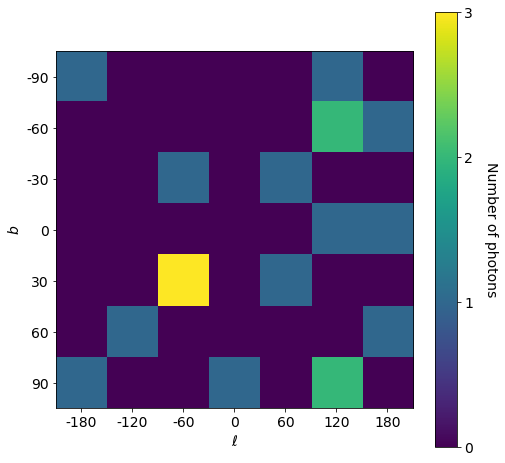

In [9]:
%matplotlib inline
fig, ax = plt.subplots(1, figsize=(8, 8))

data = [
    [1,0,0,0,0,1,0],
    [0,0,0,0,0,2,1],
    [0,0,1,0,1,0,0],
    [0,0,0,0,0,1,1],
    [0,0,3,0,1,0,0],
    [0,1,0,0,0,0,1],
    [1,0,0,1,0,2,0]
]

sky = ax.imshow(data, cmap='viridis')
ax.set_ylabel(r'$b$', fontsize=14)
ax.yaxis.set_ticks([0, 1, 2, 3, 4, 5, 6])
ax.set_yticklabels(['-90', '-60', '-30', '0', '30', '60', '90'], fontsize=14)
ax.set_xlabel(r'$\ell$', fontsize=14)
ax.xaxis.set_ticks([0, 1, 2, 3, 4, 5, 6])
ax.set_xticklabels(['-180', '-120', '-60', '0', '60', '120', '180'], fontsize=14)

cbar = plt.colorbar(sky)
cbar.ax.set_yticks([0, 1, 2, 3])
cbar.ax.set_yticklabels(['0','1','2','3'], fontsize=14)
cbar.set_label('Number of photons', rotation=270, labelpad=25, fontsize=14)

When we perform RL deconvolution, we are asking "where do my recorded photons appear in this pixelated sky?"

The above illustration shows 19 photons distributed across the sky, which is projected onto a simple 2D plane. 

The RL algorithm finds the most likely $(\ell, b)$ bin in image space in which a photon was deposited given its recorded position by the instrument in detector coordinates. 

Because the response $R$ takes us from physical to measured units, a simple method of answering our question would be to apply the inverse of the response to our measured data and immediately find the corresponding location on the sky. This would constitute a simple mapping of our CDS (data space) directly on to the sky (image space). 

However, the response matrix $R$ is not invertible! 

So instead of applying the inverse ($R^{-1}$), we apply the adjoint of the response ($R^{\dagger}$) to the data and get a sky distribution:

$R^{\dagger}D_{\phi, \psi, \chi} = S^{\dagger}(\ell, b)$ 

To first order, this gives us our familiar circles on the sky. However, this isn't great because we want an image, not a bunch of circles. This is where we turn to RL deconvolution.

Assume an initial image, typically a uniform map of some flux value. We fold it through the response, add it to the BG, and this becomes our complete expectation:

$R^{\dagger}(D_{\phi, \psi, \chi} - B_{\phi, \psi, \chi}) =$ image of the sky photons.

This $B$ is the simulated background in the CDS from before. 

The data include some background, which we subtract out, and then apply the adjoint of the response to project this data from the CDS onto our image space. 

The next thing to consider in the RL technique is that the measurement process is not uniform. 

COSI has a field of view with points at different locations of the sky at different times. We don't simply "stare" at one point of the sky. 

Refer to [Knödlseder et al. 1999](https://ui.adsabs.harvard.edu/abs/1999A%26A...345..813K/abstract) for a detailed, mathematical explanation of the algorithm.

Eq. 1 shows how the RL algorithm iteratively improves the k$^{\text{th}}$ image. The denominator of the multiplicative term, which sums over the response in the CDS, is essentially our exposure map. Note that this can lead to edge effects in the final image: at poor exposures the denominator is small and the algorithm thinks that if we record any photon where there is poor exposure, that photon must be significant. This can create bright pixels where we have poor exposure. 

The numerator of the multiplicative term compares the expectation, $e = \Sigma(R \cdot \text{image} f + b)$, to the measured data, $n$. Note that $e$ is like our model $m$ and $n$ is like our data $d$, in the language above. $e$ and $n$ are in the CDS, and the subsequent application of the response gives moves us to the image space, where we get the delta image in Eq. 3.

This algorithm is slow, so we apply an "acceleration parameter". Lambda is determined in each iteration of the algorithm. Lambda draws upon the fact that we expect photons to fall in adjacent pixels (if we see a bunch of photons in a pixel, it's more likely that an adjacent pixel also has photons than a pixel really far away has one). By applying this weight to the delta image, we can speed up the algorithm. 

To ensure that image $f_j^{k+1}$ has positive intensities, we require that $\lambda^k \cdot \delta f_j^{k} > -f_j^{k}$.

### Future work for when COSIpy is further developed (and maybe isn't dependent on MEGAlib and/or ROOT)...stay tuned...

#### for now, ignore the below

In [24]:
#rsp = np.load('Isotropic.1809keV.binnedimaging.imagingresponse.npz')

In [20]:
import response

ModuleNotFoundError: No module named 'response'

In [7]:
#import response
rsp_file = '/volumes/eos/users/jacqueline/Response_1809/Isotropic.1809keV.binnedimaging.imagingresponse.rsp.gz'

test = response.SkyResponse(rsp_file,
                            pixel_size=6,from_saved_file=False)

test.ReadMEGAlibResponse()

test.RebinToSquarePixelGrid(RegularPixelSize=6.)

NameError: name 'dataset' is not defined

<IPython.core.display.Javascript object>


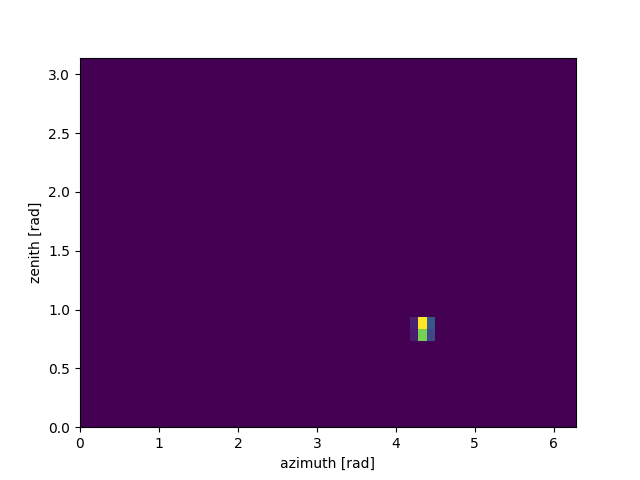

Text(0, 0.5, 'zenith [rad]')

In [6]:
plt.pcolormesh(test.l_edges, test.b_edges, test.rsp.mapping_function[200,:,:])
plt.xlabel('azimuth [rad]')
plt.ylabel('zenith [rad]')

In [7]:
print(test.rsp.response_grid_normed.shape)
print(test.rsp.mapping_function.shape)

print(test.rsp.mapping_function[100,:,:])

(30, 60, 30, 1145)

<IPython.core.display.Javascript object>


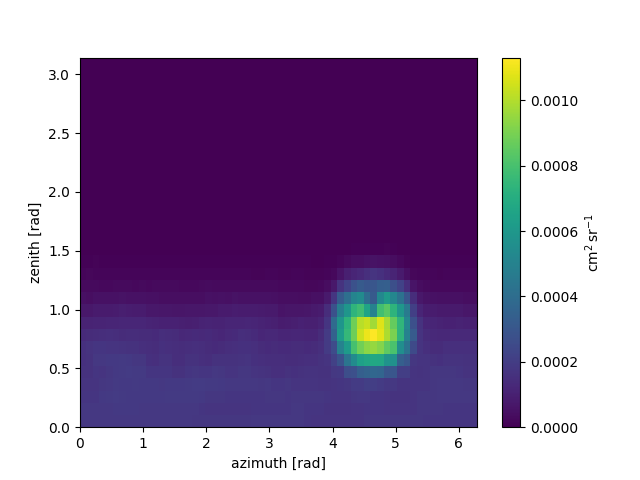

Text(0, 0.5, 'zenith [rad]')

In [11]:
tmp = np.sum(test.rsp.response_grid_normed,axis=2)#axis=4)

plt.pcolormesh(test.l_edges, test.b_edges, tmp[:,:,300])
plt.colorbar(label=r'$\mathrm{cm^2\,sr^{-1}}$')
plt.xlabel('azimuth [rad]')
plt.ylabel('zenith [rad]')

## Mess around with 3D plotting

In [12]:
x, y = np.meshgrid(test.l_edges[:-1], test.b_edges[:-1])

phi = 400
z = tmp[:,:,phi]

%matplotlib notebook
wf = plt.axes(projection='3d')
wf.plot_wireframe(x, y, z)

In [5]:
fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])

fig.update_traces(contours_z = dict(show=True, 
                                    usecolormap=True, 
                                    highlightcolor="limegreen", 
                                    project_z=True))


fig.update_layout(scene=dict(xaxis_title='azimuth [rad]',
                             yaxis_title='zenith [rad]',
                             zaxis_title=r'$cm^2 sr^{-1}$'),
                             title='CDS', 
                             autosize=False, 
                             width=900, height=700)

# scatter = fig.data[0]
# colors = ['#a3a7e4'] * 100
# scatter.marker.color = colors
# scatter.marker.size = [10] * 100
# fig.layout.hovermode = 'closest'


# # create our callback function
# def update_point(trace, points, selector):
#     c = list(scatter.marker.color)
#     s = list(scatter.marker.size)
#     for i in points.point_inds:
#         c[i] = '#bae2be'
#         s[i] = 20
#         with f.batch_update():
#             scatter.marker.color = c
#             scatter.marker.size = s


# scatter.on_click(update_point)

fig.show()

NameError: name 'z' is not defined